# Neural Style Transfer

In [1]:
from __future__ import absolute_import, division, print_function, unicode_literals
from PIL import Image

from os.path import join
import time

import torch
import torch.nn as nn
import torchvision
from torch import optim
from torchvision import transforms as tf
from torch.utils.data import DataLoader

from datasets import CachedDataset, MyDataset
from networks import AdaIN, EncoderVGG, Decoder
from loss import calculate_content_loss, calculate_style_loss

from utils import load_image, show_content_style_tradeoff_grid, show_style_and_content_img, multi_row_grid, show_images_in_a_row
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [2]:
torch.backends.cudnn.benchmark = True
# torch.set_num_threads(1)

In [3]:
content_img_path = 'C:/Users/Stefan/Desktop/Treca Godina/ORI/Image Captioning/ORI_ML/mscoco/train/img'
style_img_path = 'data/wikiart'

In [4]:
content_test_folder = 'images/input/content'
style_test_folder = 'images/input/style'
save_folder = 'saved_models/aws'

In [5]:
img_limit = 45000
cache_size = 11000
batch_size = 8 

## Define Transforms

In [6]:
transform = tf.Compose([
    tf.Resize(512),
    tf.RandomResizedCrop(256),
    tf.ToTensor()
])

In [7]:
test_transform = tf.Compose([
    tf.ToTensor(), 
#     tf.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]), # normalize to Gaussian(0,1)
])

test_transorm_crop = tf.Compose([
    tf.CenterCrop(512),
    tf.ToTensor(), 
])

test_inverse = tf.Compose([
    tf.ToPILImage()
])

## Load data

In [8]:
content_dataset = MyDataset(content_img_path, transform, img_limit)
style_dataset = MyDataset(style_img_path, transform, img_limit)

In [9]:
len(content_dataset), len(style_dataset)

(45000, 45000)

In [10]:
content_loader = DataLoader(content_dataset, batch_size, num_workers=3, shuffle=True)
style_loader = DataLoader(style_dataset, batch_size, num_workers=3, shuffle=True)

## Initialize networks

In [11]:
torch.cuda.empty_cache()

encoder = EncoderVGG().to(device)
for net in encoder.subnets:
    net = net.to(device)

adain = AdaIN().to(device)
decoder = Decoder(encoder).to(device)

In [12]:
decoder.load_state_dict(torch.load('saved_models/fin_45000_25style.pt'))

<All keys matched successfully>

In [13]:
# decoder.load_state_dict(torch.load('saved_models/aws/test_45000imgs_min_loss_style25.pt'))

In [14]:
# decoder.load_state_dict(torch.load('saved_models/aws/test_45000imgs_min_loss_style50.pt'))

## Hyperparameters

### Training Hyperparameters

In [15]:
num_epochs = 250
print_every = 1
show_result_every = 1
save_every = 3

### Algorithm hyperparameters

In [16]:
start_lr =  1e-4
end_lr = 1e-5
optimizer = optim.Adam(decoder.parameters(), lr=start_lr)
criterion = nn.MSELoss()
c_weight = 10
s_weight = 50

In [17]:
# Calculate lr_decay from start, end learning rate and number of epochs
lr_decay = (start_lr / end_lr - 1) / num_epochs

In [18]:
def adjust_learning_rate(optimizer, epoch, start_lr=start_lr, lr_decay=lr_decay):
    new_lr = calculate_new_lr(start_lr, lr_decay, epoch)
    for param_group in optimizer.param_groups:
        param_group['lr'] = new_lr
    return new_lr

def calculate_new_lr(start_lr, lr_decay, epoch):
    return start_lr / (1.0 + lr_decay * epoch)

### Visualize learning rate through epochs

In [19]:
def visualize_learning_rate():
    x = list(range(0, 1000))
    y = [calculate_new_lr(1e-4, 5e-3, i) for i in range(len(x))]
    
    plt.plot(x, y)
    print(f'Start learning rate {(y[0])} and End learning rate {y[-1]}')
 
 # visualize_learning_rate()

## Training

### Set fixed images to see algorithm improvement over time

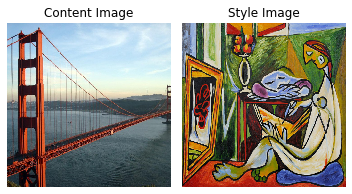

In [20]:
fixed_c_path = join(content_test_folder, 'golden_gate.jpg')
fixed_s_path = join(style_test_folder, 'la_muse.jpg')

fixed_c_img = test_transform(load_image(fixed_c_path)).to(device)
fixed_s_img = test_transform(load_image(fixed_s_path)).to(device)

show_style_and_content_img(fixed_c_img, fixed_s_img, test_inverse, figsize=(5,10))

In [21]:
def test(c_img, s_img, alpha=1., clamp=True):
    torch.cuda.empty_cache()
    encoder.eval()
    decoder.eval()
    
    c_img = c_img.unsqueeze(0)
    s_img = s_img.unsqueeze(0)

    encoded_style_test = encoder(s_img)
    encoded_content_test = encoder(c_img)[-1]

    adain_out_test = adain(encoded_content_test, encoded_style_test[-1], alpha)

    out_img = decoder(adain_out_test).cpu().squeeze(0)
    if clamp:
        out_img = torch.clamp(out_img, -1, 1)
    return test_inverse(out_img)

In [22]:
def interpolate(c_img, s_images, weights=None, alpha=1.):
    if weights is None:
        weights = [1/len(s_images)] * len(s_images)
    else:
        assert len(weights) == len(s_images)
    torch.cuda.empty_cache()
    encoder.eval()
    decoder.eval()
    
    c_img = c_img.unsqueeze(0)    
    
    encoded_content_test = encoder(c_img)[-1]
    encoded_style_test = [None] * len(s_images)   
    for i in range(len(s_images)):
        encoded_style_test[i] = encoder(s_images[i].unsqueeze(0))[-1]
    
    adain_out_test = adain(encoded_content_test, encoded_style_test[0], alpha) * weights[0]
    for i in range(1, len(encoded_style_test)):
        adain_out_test += adain(encoded_content_test, encoded_style_test[i], alpha) * weights[i]

    out_img = decoder(adain_out_test).cpu().squeeze(0)
    return test_inverse(torch.clamp(out_img, -1, 1))

### Single training step

In [22]:
def train_step(content_batch, style_batch):
    optimizer.zero_grad()
    
    encoded_style = encoder(style_batch)
    encoded_content = encoder(content_batch)[-1]
    
    adain_out = adain(encoded_content, encoded_style[-1])
    
    out_img_batch = decoder(adain_out)
    
    encoded_out_batch = encoder(out_img_batch)
    
    content_loss = calculate_content_loss(encoded_out_batch[-1], adain_out, criterion)
    style_loss = calculate_style_loss(encoded_out_batch, encoded_style, criterion)
    loss = s_weight * style_loss + c_weight * content_loss
    loss.backward()
    optimizer.step()
    return loss

In [23]:
min_loss = float('Inf')
min_loss_save_cutoff = 0

### Training loop

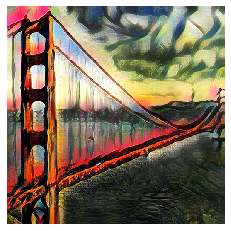

Epoch 0 Loss 36.7599 Learning Rate 1.000e-04 Min Loss 36.76
Time taken for epoch 2248 sec



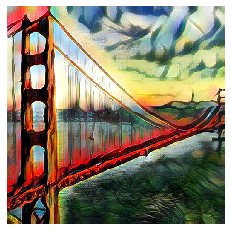

Epoch 1 Loss 36.7997 Learning Rate 9.653e-05 Min Loss 36.76
Time taken for epoch 2246 sec



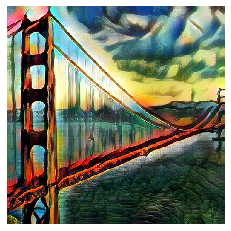

Epoch 2 Loss 35.6363 Learning Rate 9.328e-05 Min Loss 35.64
Time taken for epoch 2243 sec



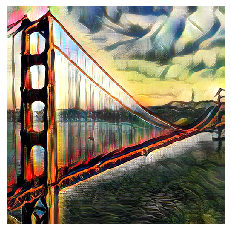

Epoch 3 Loss 35.5296 Learning Rate 9.025e-05 Min Loss 35.53
Time taken for epoch 2243 sec



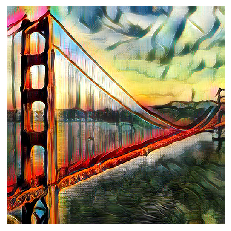

Epoch 4 Loss 34.8272 Learning Rate 8.741e-05 Min Loss 34.83
Time taken for epoch 2244 sec



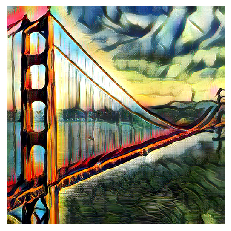

Epoch 5 Loss 34.1135 Learning Rate 8.475e-05 Min Loss 34.11
Time taken for epoch 2244 sec



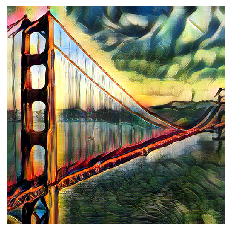

Epoch 6 Loss 33.6940 Learning Rate 8.224e-05 Min Loss 33.69
Time taken for epoch 2244 sec



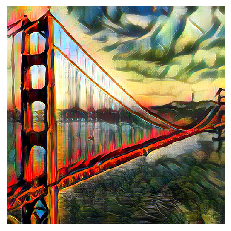

Epoch 7 Loss 33.2252 Learning Rate 7.987e-05 Min Loss 33.23
Time taken for epoch 2243 sec



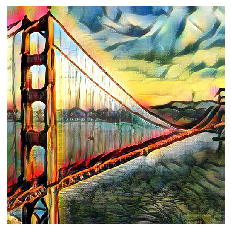

Epoch 8 Loss 32.6539 Learning Rate 7.764e-05 Min Loss 32.65
Time taken for epoch 2246 sec



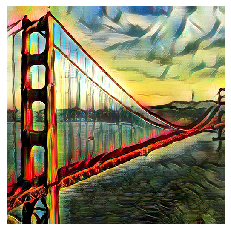

Epoch 9 Loss 32.4555 Learning Rate 7.553e-05 Min Loss 32.46
Time taken for epoch 2246 sec



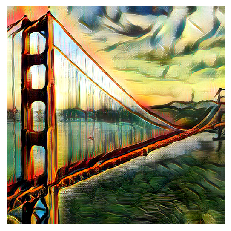

Epoch 10 Loss 32.1216 Learning Rate 7.353e-05 Min Loss 32.12
Time taken for epoch 2245 sec



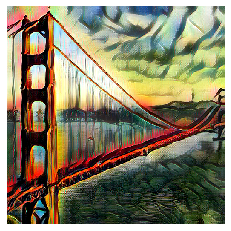

Epoch 11 Loss 31.7492 Learning Rate 7.163e-05 Min Loss 31.75
Time taken for epoch 2246 sec



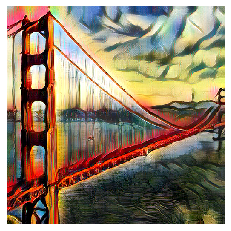

Epoch 12 Loss 31.6995 Learning Rate 6.983e-05 Min Loss 31.70
Time taken for epoch 2266 sec



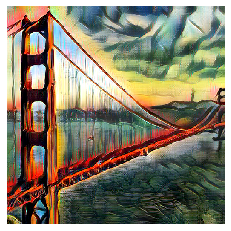

Epoch 13 Loss 31.1994 Learning Rate 6.812e-05 Min Loss 31.20
Time taken for epoch 2327 sec



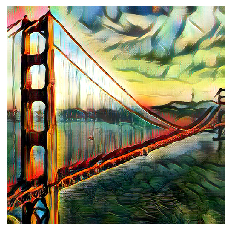

Epoch 14 Loss 31.1031 Learning Rate 6.649e-05 Min Loss 31.10
Time taken for epoch 2321 sec



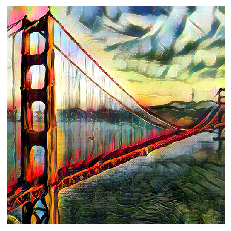

Epoch 15 Loss 30.7172 Learning Rate 6.494e-05 Min Loss 30.72
Time taken for epoch 2287 sec



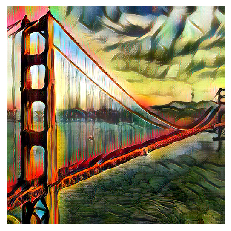

Epoch 16 Loss 30.5852 Learning Rate 6.345e-05 Min Loss 30.59
Time taken for epoch 2286 sec



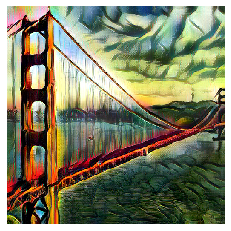

Epoch 17 Loss 30.3545 Learning Rate 6.203e-05 Min Loss 30.35
Time taken for epoch 2335 sec



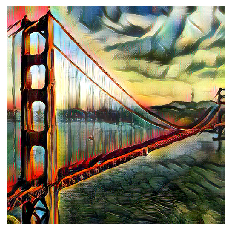

Epoch 18 Loss 30.1362 Learning Rate 6.068e-05 Min Loss 30.14
Time taken for epoch 2316 sec



KeyboardInterrupt: 

In [39]:
def train(start_epoch=0):
    global min_loss
    
    decoder.train()
    encoder.train()
    
    for epoch in range(start_epoch, num_epochs):
        start = time.time()
        total_loss = 0
        steps = 0
        for content_batch, style_batch in zip(content_loader, style_loader):
            content_batch, style_batch = content_batch.to(device), style_batch.to(device)
            total_loss += train_step(content_batch, style_batch).detach().item()
            steps += 1
        
        avg_batch_loss = total_loss / steps
        
        new_lr = adjust_learning_rate(optimizer, epoch)
        
        if epoch % show_result_every == 0:
            plt.axis('off')
            plt.imshow(test(fixed_c_img, fixed_s_img))
            plt.show()
        
        if avg_batch_loss < min_loss:
            min_loss = avg_batch_loss
            if epoch >= min_loss_save_cutoff:
                torch.save(decoder.state_dict(), f'{save_folder}/test_{img_limit}imgs_min_loss_style{s_weight}.pt')
        if epoch and epoch % save_every == 0:
            torch.save(decoder.state_dict(), f'{save_folder}/test_{img_limit}imgs_loss_{avg_batch_loss:.{2}f}_style{s_weight}_epoch{epoch}.pt')
        
        if epoch % print_every == 0:
            print(f'Epoch {epoch} Loss {avg_batch_loss:.{4}f} Learning Rate {new_lr:.3e} Min Loss {min_loss:.{2}f}')
            print(f'Time taken for epoch {(time.time() - start):.{0}f} sec\n')

train()    

In [219]:
# torch.save(decoder.state_dict(), 'saved_models/fin_45000_25style.pt')

## Testing

In [40]:
content_img = fixed_c_img
style_img = fixed_s_img

In [23]:
content_img = test_transform(load_image(join(content_test_folder, 'chicago.jpg'))).to(device)

In [23]:
style_dataset.img_names[1824]

'102166.jpg'

In [38]:
from random import randrange
idx = randrange(img_limit)
print(style_dataset.img_names[idx])
style_img = style_dataset.get_no_transform(idx).to(device)
test_inverse(style_img.cpu())

16272.jpg


In [42]:
style_img = test_transform(load_image(join(style_test_folder, '18299.jpg'))).to(device)

In [45]:
style_img = test_transform(load_image(join(style_test_folder, 'asheville.jpg'))).to(device)

In [47]:
style_img = test_transform(load_image(join(style_test_folder, '101862.jpg'))).to(device)

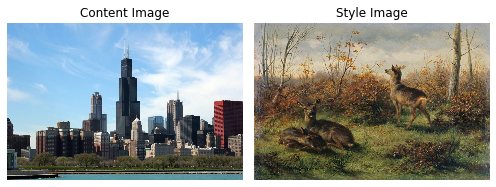

In [48]:
show_style_and_content_img(content_img, style_img, test_inverse)

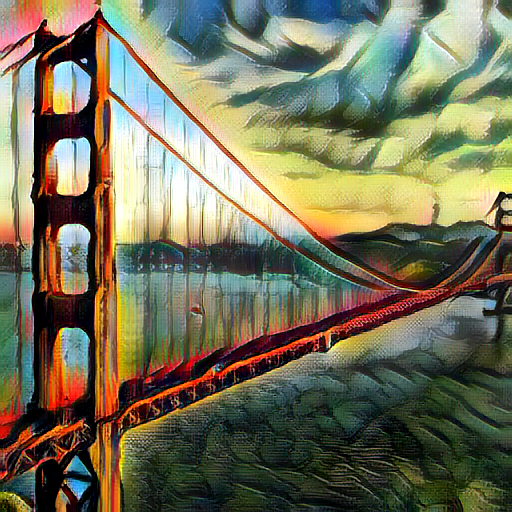

In [41]:
test(content_img, style_img, alpha=1.0) # 50 style

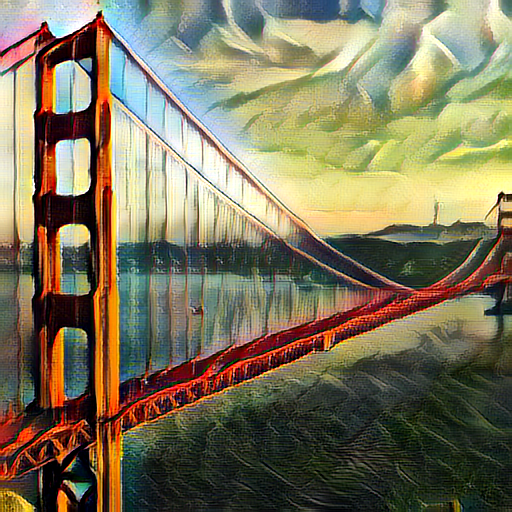

In [25]:
test(content_img, style_img)   # 25 style new

## Content-Style Tradeoff

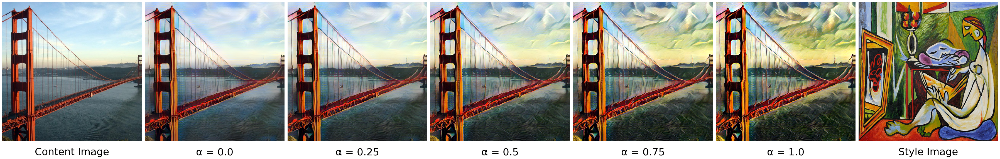

<Figure size 432x288 with 0 Axes>

In [39]:
show_content_style_tradeoff_grid(content_img, style_img, test, test_inverse)

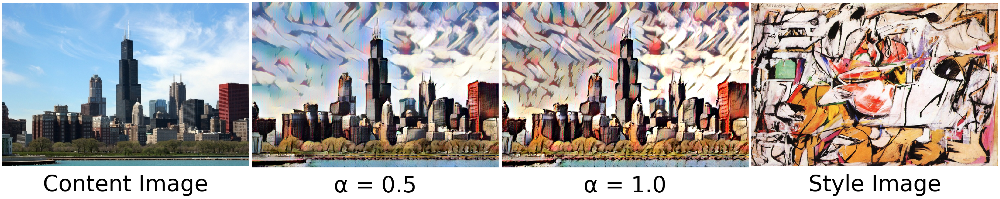

<Figure size 432x288 with 0 Axes>

In [131]:
show_content_style_tradeoff_grid(content_img, style_img, test, test_inverse, alpha_min=0.5, alpha_max = 1., alpha_step=0.5)

## Style interpolation

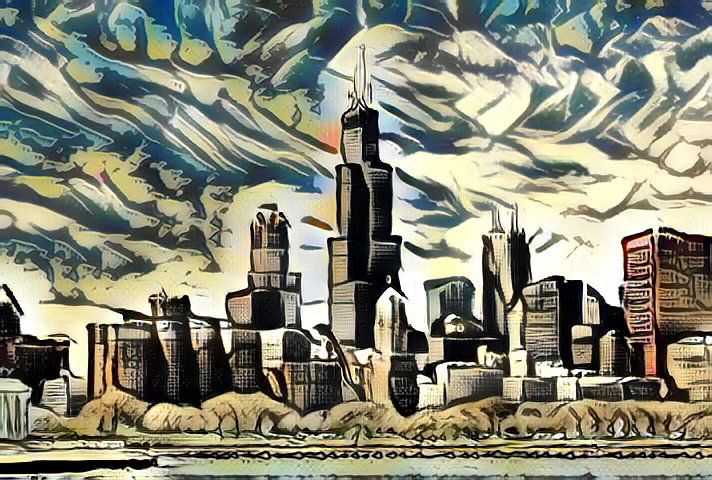

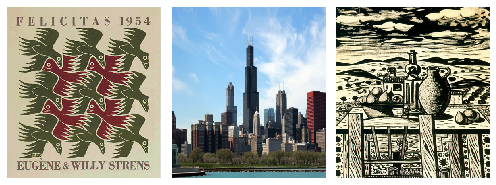

In [59]:
s1_int = test_transform(load_image(join(style_test_folder, '18299.jpg'))).to(device)
s2_int = test_transform(load_image(join(style_test_folder, '18149.jpg'))).to(device)
c_int = test_transform(load_image(join(content_test_folder, 'chicago.jpg'))).to(device)

show_images_in_a_row([s1_int, c_int, s2_int], test_inverse)
interpolate(c_int, [s1_int, s2_int], weights=[0.5, 0.5])

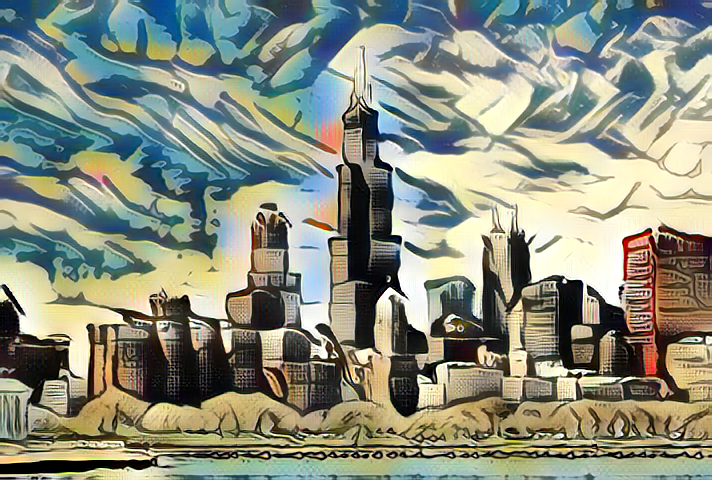

In [60]:
interpolate(c_int, [s1_int, s2_int], weights=[0.85, 0.15])

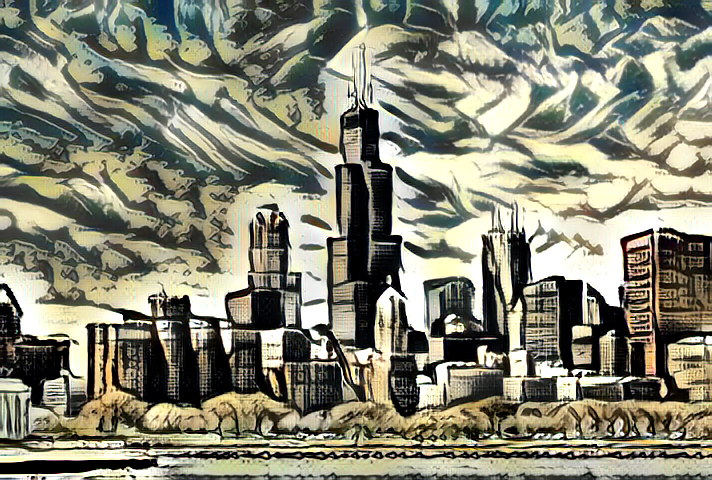

In [61]:
interpolate(c_int, [s1_int, s2_int], weights=[0.15, 0.85])

## Images for the poster

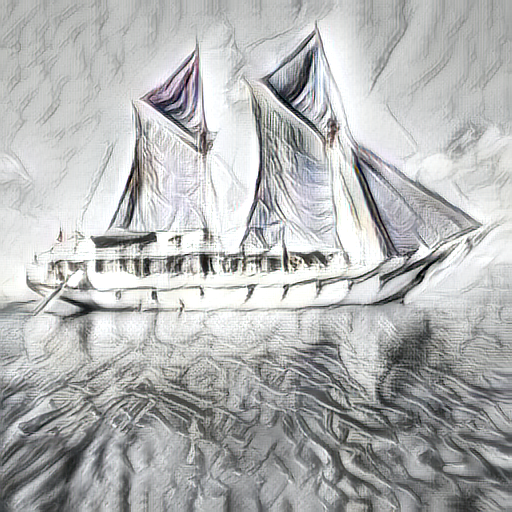

In [133]:
ci = test_transform(load_image(join(content_test_folder, 'sailboat.jpg'))).to(device)
si = test_transform(load_image(join(style_test_folder, 'sketch.png'))).to(device)
test(ci, si) # 50st

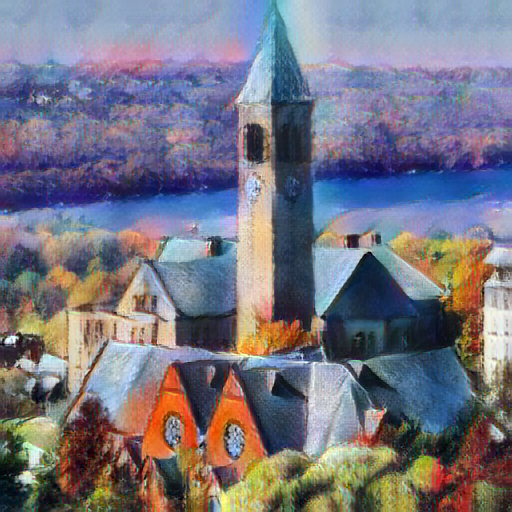

In [143]:
ci = test_transorm_crop(load_image(join(content_test_folder, 'cornell.jpg'))).to(device)
si = test_transform(load_image(join(style_test_folder, 'woman_with_hat_matisse.jpg'))).to(device)
test(ci, si) # 50st

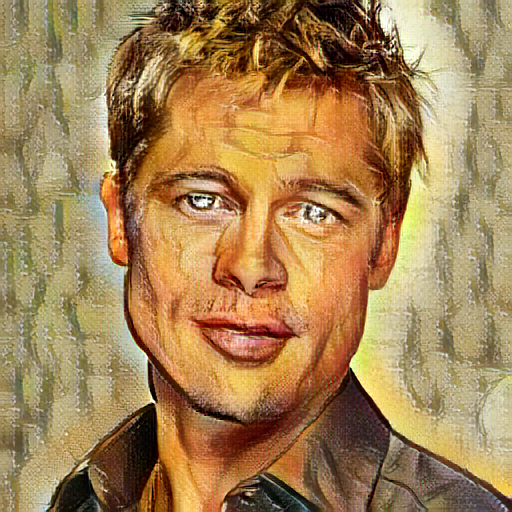

In [136]:
ci = test_transform(load_image(join(content_test_folder, 'brad_pitt.jpg'))).to(device)
si = test_transform(load_image(join(style_test_folder, 'picasso_self_portrait.jpg'))).to(device)
test(ci, si) # 50st

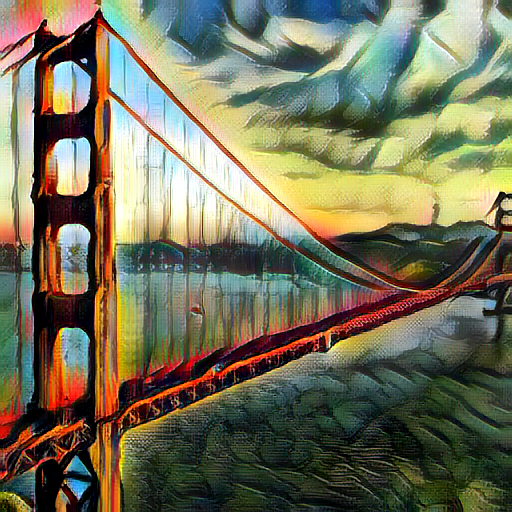

In [138]:
ci = test_transform(load_image(join(content_test_folder, 'golden_gate.jpg'))).to(device)
si = test_transform(load_image(join(style_test_folder, 'la_muse.jpg'))).to(device)
test(ci, si) # 50st

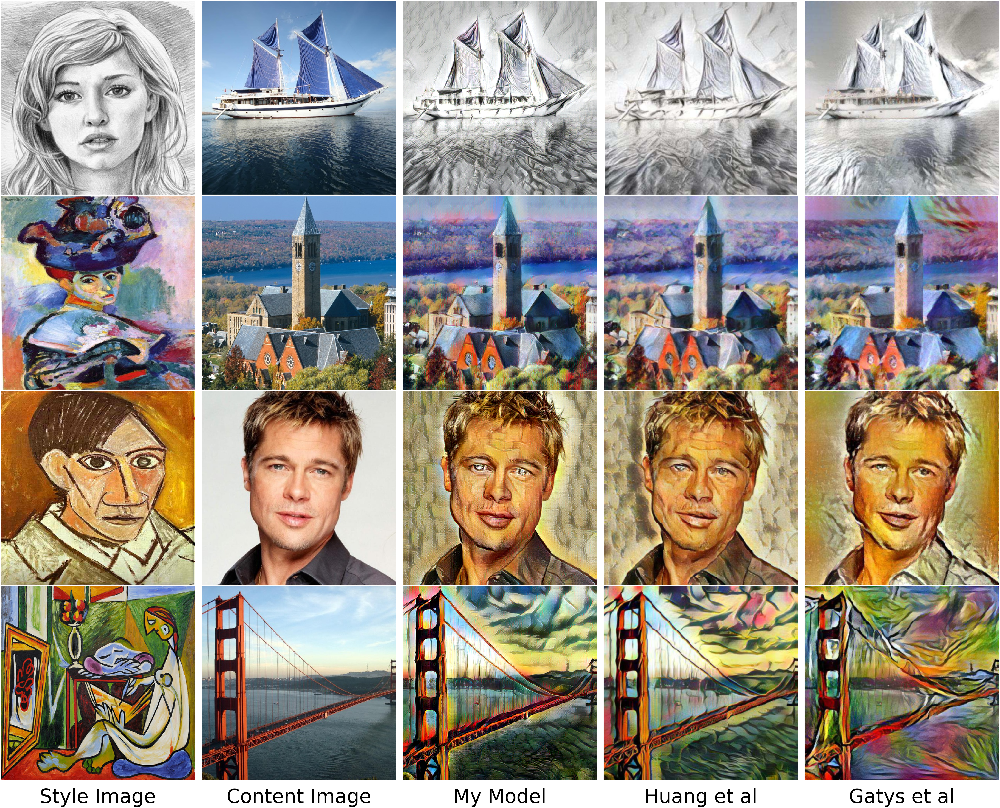

In [218]:
grid_img_folder = 'poster/grid_result_images'
grid_c_imgs = ['sailboat.jpg', 'cornell-square.png', 'brad_pitt.jpg', 'golden_gate.jpg']
grid_s_imgs = ['sketch.png', 'woman_with_hat_matisse.jpg', 'picasso_self_portrait.jpg', 'la_muse.jpg']
grid_gen_imgs = ['boat', 'tower', 'brad', 'bridge']
gen_suffix = ['-my.png', '-adain.png', '-gatys.png']
text = ['Style Image', 'Content Image', 'My Model', 'Huang et al', 'Gatys et al']

f, axarr = plt.subplots(4, 5, figsize=(100, 80))
for i in range(len(grid_c_imgs)):
    [ax.axis('off') for ax in axarr[i]]
    # style img
    axarr[i][0].imshow(load_image(join(style_test_folder, grid_s_imgs[i])).resize((512,512)))
     # content img
    axarr[i][1].imshow(load_image(join(content_test_folder, grid_c_imgs[i])))
    
    for j in range(len(gen_suffix)):
        axarr[i][2+j].imshow(load_image(join(grid_img_folder, grid_gen_imgs[i] + gen_suffix[j])))

for idx, ax in enumerate(axarr[-1]):
    ax.text(0.5, -0.12, text[idx], size=140, ha="center", transform=ax.transAxes)
    
plt.tight_layout()